# Exploratory Data Analysis for ICO Fraud Detection Project

## 1. File with information about ICO

In [5]:
import pandas as pd
import os
import re
import pytz
from datetime import datetime, timedelta
import plotly.graph_objects as go
import pickle
pd.options.plotting.backend = "plotly"

In [15]:
df_info = pd.read_csv('lista_ico_2020-08-17_tab3.csv', sep=',')
df_info.set_index('ico',inplace=True)

In [16]:
df_info.head()

,adress,fraud,start_date,market_start_date,diff_days,market_days,size_ok,price,market_cap,o_concur,biggest_holder,exchange,contract,date_analysis,code,site,social_media
ico,,,,,,,,,,,,,,,,,
0X,0xe41d2489571d322189246dafa5ebde1f4699f498,0,2017-08-11,2017-08-15,4,1124,NaN,NaN,45.0,x,2,6,14,2018-02-11,NaN,NaN,NaN
0XCERT,0x83e2be8d114f9661221384b3a50d24b96a5653f5,1,2018-06-26,2018-07-11,15,794,x,NaN,NaN,NaN,12,2,0,2019-01-07,x,x,x
4NEW,0x241ba672574a78a3a604cdd0a94429a73a84a324,1,2018-08-20,2018-08-20,0,754,x,NaN,NaN,NaN,50,7,0,2019-02-16,x,NaN,NaN
ABULABA,0xd938137e6d96c72e4a6085412ada2dad78ff89c4,1,2018-04-19,2018-12-16,241,636,NaN,x,NaN,NaN,13,7,41,2019-06-14,x,NaN,NaN
AELF,0xbf2179859fc6d5bee9bf9158632dc51678a4100e,0,2017-12-18,2017-12-21,3,996,NaN,NaN,154.0,x,13,10,0,2018-06-19,NaN,NaN,NaN


## 2. Extracting the data

In [45]:
path_to_csvs = '/home/gabriel/Documents/Repos/time_series_study/data_and_models/all_icos/'
list_icos = df_info.index.to_list()

In [42]:
%%time
list_values = []
for ico in list_icos:
    #print(ico)
    ico_csv= f'{path_to_csvs}{ico}.csv'
    is_fraud = df_info.at[ ico, 'fraud']
    try:
        df_current_ico = pd.read_csv(ico_csv)
        number_transactions = df_current_ico.shape[0] 
        list_values.append([ico,
                           number_transactions,
                           df_current_ico.RECEIPT_GAS_USED.astype(float).sum()/number_transactions,
                           df_current_ico.GAS.astype(float).sum()/number_transactions,
                           len(df_current_ico.FROM_ADDRESS.unique())/number_transactions,
                           len(df_current_ico.TO_ADDRESS.unique())/number_transactions,
                           is_fraud]
                           )
    except FileNotFoundError:
        print(f'Error on ICO: {ico}')
    
    

Error on ICO: ERNTOKEN
Error on ICO: FRUITIONTOKEN
Error on ICO: GADIUNTRUSTWALLET
Error on ICO: POWERLEDGER
CPU times: user 1min 2s, sys: 4.37 s, total: 1min 7s
Wall time: 1min 11s


In [67]:
df_eda = pd.DataFrame(list_values, columns=['ico', 
                                   'Número de Transações', 
                                   'Média Gas Receipt', 
                                   'Média Gas',
                                   'Média From Adress',
                                   'Média To Address',
                                   'Fraude'])
df_eda.head()

,ico,Número de Transações,Média Gas Receipt,Média Gas,Média From Adress,Média To Address,Fraude
0,0X,301485,5.876486e+04,1.475736e+05,0.223255,0.332806,0
1,0XCERT,21145,5.786318e+04,1.220356e+05,0.143580,0.783921,1
2,4NEW,22563,1.527679e+06,1.651859e+06,0.172583,0.501972,1
3,ABULABA,4214,4.109039e+04,1.244334e+05,0.204794,0.387518,1
4,AELF,109117,1.308478e+06,1.595182e+06,0.163256,0.375835,0


## 2. Visual exploration of data

### 2.1. Boxplot - Total transactions

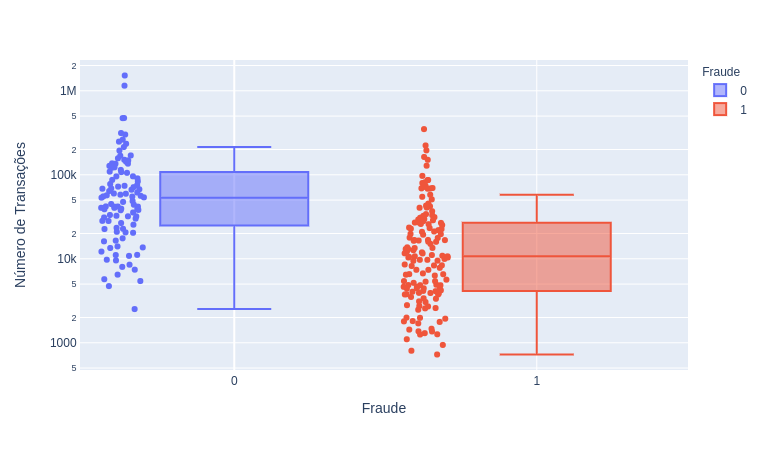

In [55]:
import plotly.express as px
fig = px.box(df_eda, x="Fraude", y="Número de Transações", points="all", log_y=True, color='Fraude')
fig.show()

### 2.2. Boxplot - Média Gas Receipt

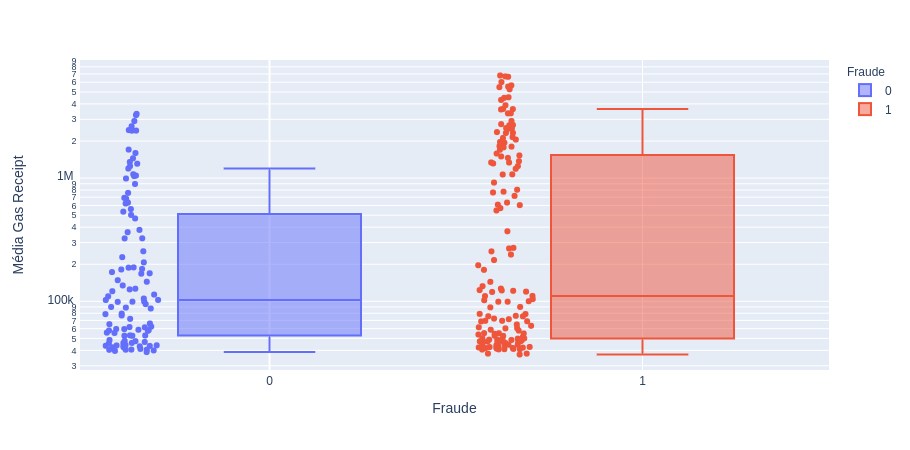

In [59]:
fig = px.box(df_eda, x="Fraude", y="Média Gas Receipt", points="all", log_y=True, color='Fraude')
fig.show()

### 2.3. Boxplot - Média Gas

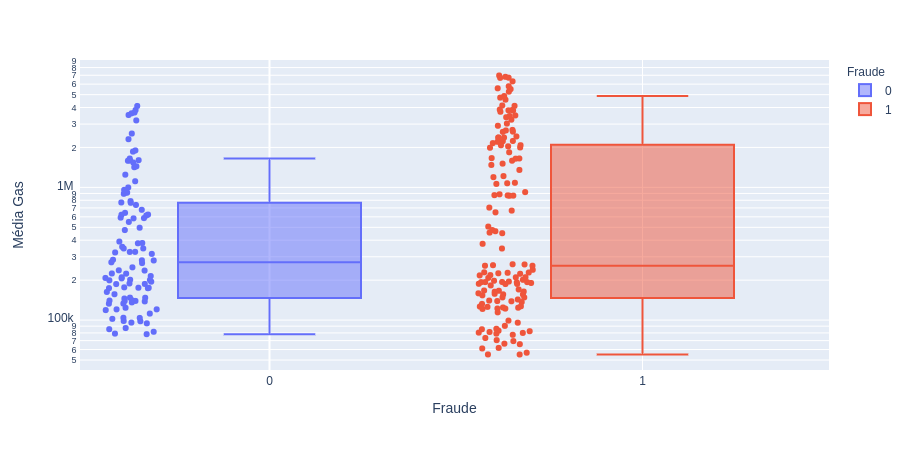

In [60]:
fig = px.box(df_eda, x="Fraude", y="Média Gas", points="all", log_y=True, color='Fraude')
fig.show()

### 2.4. Boxplot - Média From Adress

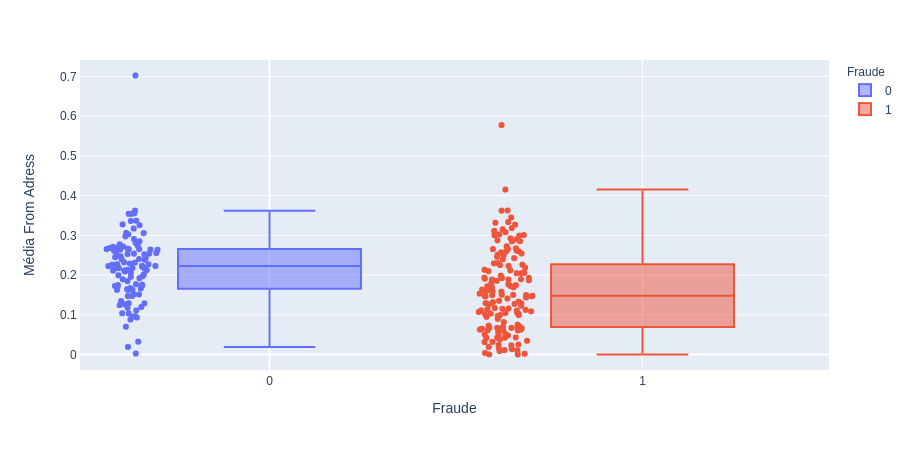

In [62]:
fig = px.box(df_eda, x="Fraude", y="Média From Adress", points="all", log_y=False, color='Fraude')
fig.show()

### 2.5. Boxplot - Média To Adress

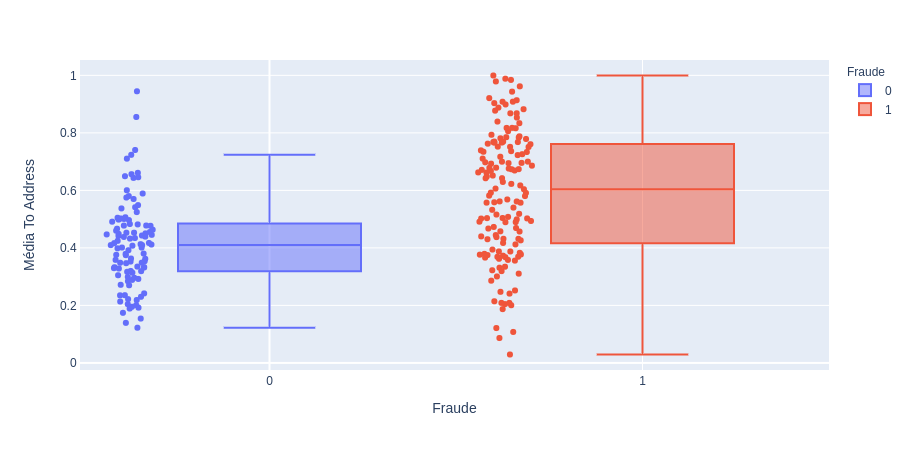

In [68]:
fig = px.box(df_eda, x="Fraude", y="Média To Address", points="all", log_y=False, color='Fraude')
fig.show()

## 3. Histogram with Difference between transactions

In [80]:
%%time
dict_ico_diff = {}
for ico in list_icos:
    #print(ico)
    ico_csv= f'{path_to_csvs}{ico}.csv'
    is_fraud = df_info.at[ ico, 'fraud']
    try:
        df_current_ico = pd.read_csv(ico_csv)
        df_current_ico.BLOCK_TIMESTAMP = pd.to_datetime(df_current_ico.BLOCK_TIMESTAMP)
        dict_ico_diff[ico] = df_current_ico.BLOCK_TIMESTAMP.diff().dt.seconds
    except (FileNotFoundError, TypeError):
        print(f'Error on ICO: {ico}')
    

Error on ICO: ERNTOKEN
Error on ICO: FRUITIONTOKEN
Error on ICO: GADIUNTRUSTWALLET
Error on ICO: POWERLEDGER
CPU times: user 27min 46s, sys: 4.72 s, total: 27min 51s
Wall time: 28min


In [82]:
len(dict_ico_diff.keys())

254

In [90]:
dict_ico_diff_min = {key:value/60 for key,value in dict_ico_diff.items()}

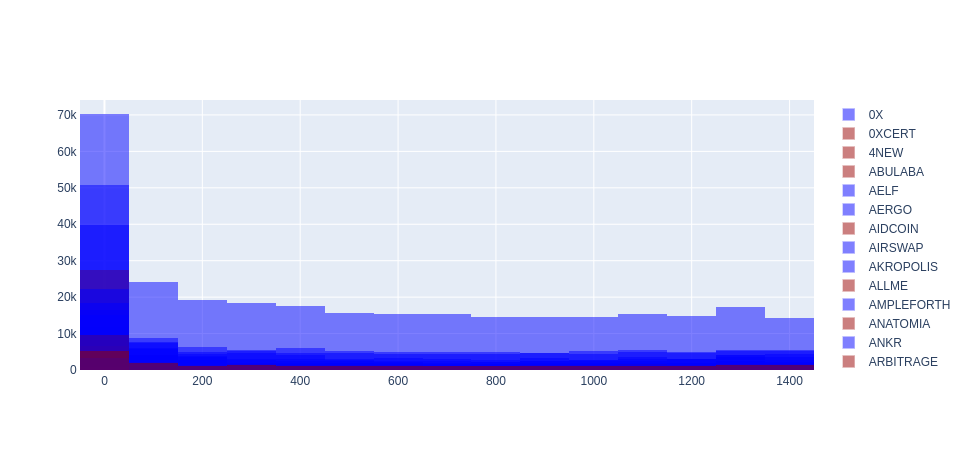

In [100]:
fraud_dict = {1: 'fraud', 0:'success'}
color_dict = {1: 'rgba(152, 0, 0, .5)', 0: 'rgba(0,0,255,.5)'}
list_keys = list(dict_ico_diff_min.keys())
fig = go.Figure()
for ico in list_keys[:20]:
    is_fraud = df_info.at[ ico, 'fraud']
    fig.add_trace(go.Histogram(x=dict_ico_diff_min.get(ico).tolist(),
                            showlegend=True,
                            name=ico,
                            nbinsx=20,
                            #legendgroup = fraud_dict.get(is_fraud),
                            marker_color=color_dict.get(is_fraud)))
fig.update_layout(barmode='overlay')

fig.show()

## 4. Autocorrelation

In [101]:
%%time
dict_ico_autocorr = {}
for ico in list_icos[:10]:
    
    ico_csv= f'{path_to_csvs}{ico}.csv'
    is_fraud = df_info.at[ ico, 'fraud']
    try:
        df_current_ico = pd.read_csv(ico_csv)
        df_current_ico.BLOCK_TIMESTAMP = pd.to_datetime(df_current_ico.BLOCK_TIMESTAMP)
        dict_ico_autocorr[ico] = df_current_ico.GAS.autocorr()
    except (FileNotFoundError, TypeError):
        print(f'Error on ICO: {ico}')
    

CPU times: user 1min 36s, sys: 372 ms, total: 1min 37s
Wall time: 1min 37s


In [102]:
dict_ico_autocorr

{'0X': 0.5946383799094649,
 '0XCERT': 0.9133533308957066,
 '4NEW': 0.9818627647703226,
 'ABULABA': 0.7471249816984668,
 'AELF': 0.9925829948980196,
 'AERGO': 0.9922715489486846,
 'AIDCOIN': 0.9953281550686309,
 'AIRSWAP': 0.6136768189688274,
 'AKROPOLIS': 0.983227396049446,
 'ALLME': 0.9838311357606907}